# 03 - Interactive Viz

## Deadline

Wednesday November 8th, 2017 at 11:59PM

## Important Notes

- Make sure you push on GitHub your Notebook with all the cells already evaluated
- Note that maps do not render in a standard Github environment : you should export them to HTML and link them in your notebook.
- Remember that `.csv` is not the only data format. Though they might require additional processing, some formats provide better encoding support.
- Don't forget to add a textual description of your thought process, the assumptions you made, and the solution you plan to implement!
- Please write all your comments in English, and use meaningful variable names in your code

## Background

In this homework we will be exploring interactive visualization, which is a key ingredient of many successful data visualizations (especially when it comes to infographics).

Unemployment rates are major economic metrics and a matter of concern for governments around the world. Though its definition may seem straightforward at first glance (usually defined as the number of unemployed people divided by the active population), it can be tricky to define consistently. For example, one must define what exactly unemployed means : looking for a job ? Having declared their unemployment ? Currently without a job ? Should students or recent graduates be included ? We could also wonder what the active population is : everyone in an age category (e.g. `16-64`) ? Anyone interested by finding a job ? Though these questions may seem subtle, they can have a large impact on the interpretation of the results : `3%` unemployment doesn't mean much if we don't know who is included in this percentage. 

In this homework you will be dealing with two different datasets from the statistics offices of the European commission ([eurostat](http://ec.europa.eu/eurostat/data/database)) and the Swiss Confederation ([amstat](https://www.amstat.ch)). They provide a variety of datasets with plenty of information on many different statistics and demographics at their respective scales. Unfortunately, as is often the case is data analysis, these websites are not always straightforward to navigate. They may include a lot of obscure categories, not always be translated into your native language, have strange link structures, … Navigating this complexity is part of a data scientists' job : you will have to use a few tricks to get the right data for this homework.

For the visualization part, install [Folium](https://github.com/python-visualization/folium) (*HINT*: it is not available in your standard Anaconda environment, therefore search on the Web how to install it easily!). Folium's `README` comes with very clear examples, and links to their own iPython Notebooks -- make good use of this information. For your own convenience, in this same directory you can already find two `.topojson` files, containing the geo-coordinates of 

- European countries (*liberal definition of EU*) (`topojson/europe.topojson.json`, [source](https://github.com/leakyMirror/map-of-europe))
- Swiss cantons (`topojson/ch-cantons.topojson.json`) 

These will be used as an overlay on the Folium maps.

## Assignment

In [3]:
%matplotlib inline
import os
import pandas as pd
import numpy as np
import json
import folium
import bisect
import branca.colormap as cm
import copy
import vincent

# Table of Contents
 <p><div class="lev1"><a href="#Task-1"><span class="toc-item-num">Task 1</span></a></div>
 <div class="lev1"><a href="#Task-2"><span class="toc-item-num">Task 2</span></a></div>
 <div class="lev1"><a href="#Task-3"><span class="toc-item-num">Task 3</span></a></div>
 <div class="lev1"><a href="#Task-4-(BONUS)"><span class="toc-item-num">Task 4 (<i>BONUS</i>)</span></a></div></p>

## Task 1

Go to the [eurostat](http://ec.europa.eu/eurostat/data/database) website and try to find a dataset that includes the european unemployment rates at a recent date.

   Use this data to build a [Choropleth map](https://en.wikipedia.org/wiki/Choropleth_map) which shows the unemployment rate in Europe at a country level. Think about [the colors you use](https://carto.com/academy/courses/intermediate-design/choose-colors-1/), how you decided to [split the intervals into data classes](http://gisgeography.com/choropleth-maps-data-classification/) or which interactions you could add in order to make the visualization intuitive and expressive. Compare Switzerland's unemployment rate to that of the rest of Europe.

## Task 1 Solution

The data used can be found in the following location:
**insert correct image !!!!!!!!!!!!!!!!!!**

**EXPLAIN PREPROCESSING**
As the final step of our pre-processing of the dataset, we dropped the following rows:
 * 	Euro area (EA11-2000, EA12-2006, EA13-2007, EA15-2008, EA16-2010, EA17-2013, EA18-2014, EA19)
 * 	Euro area (19 countries)
 * 	Euro area (18 countries)
 * 	Euro area (18 countries)
 * 	European Union (27 countries)
 * 	United States
 * 	Japan

It is important to note that this dataset includes Switzerland.


DATASET: Unemployment rates by sex, age and nationality (%) [lfsa_urgan]

AGE: From 15 to 74 years

SEX: Total

CITIZEN: Total

UNIT: Percentage



In [4]:
eu_topo_path = os.path.join('topojson', 'europe.topojson.json')
eu_topo_data = json.load(open(eu_topo_path))
eu_unemply_data_file =  os.path.join('data', 'lfsa_urgan_1_Data.csv')
eu_unemply_data = pd.read_csv(eu_unemply_data_file)
eu_unemply_data.head()

,TIME,GEO,SEX,AGE,CITIZEN,UNIT,Value
0,2016,Belgium,Total,From 15 to 74 years,Total,Percentage,7.8
1,2016,Bulgaria,Total,From 15 to 74 years,Total,Percentage,7.6
2,2016,Czech Republic,Total,From 15 to 74 years,Total,Percentage,4.0
3,2016,Denmark,Total,From 15 to 74 years,Total,Percentage,6.2
4,2016,Germany (until 1990 former territory of the FRG),Total,From 15 to 74 years,Total,Percentage,4.1


Let's take a look at the number of null values:

In [5]:
print('Missing values 2016: ' + str(eu_unemply_data[eu_unemply_data['TIME'] == 2016]['Value'].isnull().sum()))

Missing values 2016: 0


Since there were no missing values in this dataset, which makes it the most comprehensive, yet recent one, we decided to use it for our further analysis

The columns of the *eu_unemply_data* Data Frame that were relevant to us at this step were the *GEO* and *Value* columns. We renamed them to *Country* and *Rate*.

In [6]:
eu_unemply_data = eu_unemply_data[['GEO', 'Value']]
eu_unemply_data.rename(columns={'GEO': 'Country', 'Value': 'Rate'}, inplace=True)
eu_unemply_data.reset_index(drop = True, inplace = True)
eu_unemply_data

,Country,Rate
0,Belgium,7.8
1,Bulgaria,7.6
2,Czech Republic,4.0
3,Denmark,6.2
4,Germany (until 1990 former territory of the FRG),4.1
5,Estonia,6.8
6,Ireland,7.9
7,Greece,23.6
8,Spain,19.6
9,France,10.1


As can be seen in the created DataFrame, the rows that contain the information about unemployment rates in both Germany and Macedonia have atypical values in the *Country* column. In order to simplify future work with this DataFrame, we have reset the *Country* column value for these rows to values that match those found in the *europe.topojson.json* file.

In [7]:
%%capture 
# %%capture  is used o prevent the cell from outputing unnecassary data
DE_index = eu_unemply_data.loc[eu_unemply_data['Country'] == 'Germany (until 1990 former territory of the FRG)'].index[0]
eu_unemply_data.set_value(DE_index, 'Country', 'Germany')
MK_index = eu_unemply_data.loc[eu_unemply_data['Country'] == 'Former Yugoslav Republic of Macedonia, the'].index[0]
eu_unemply_data.set_value(MK_index, 'Country', 'The former Yugoslav Republic of Macedonia')

Afterwards, we plotted the *choropleth* map which shows the unemployment rate in Europe at a country level. This function was used to bind the data from the *eu_unemply_data* Data Frame with the map, in order to visualise the data we gathered from json files.

In [8]:
eu_center_coord = [54.9, 25.316667] #disputable -- https://en.wikipedia.org/wiki/Geographical_midpoint_of_Europe 

m_eu = folium.Map(eu_center_coord, tiles='cartodbpositron', zoom_start=4)
m_eu.choropleth(
    geo_data = eu_topo_data,
    name = 'Unemployment Rates in Europe',
    topojson = 'objects.europe',
    data = eu_unemply_data,
    columns = ['Country', 'Rate'],
    key_on = 'feature.properties.NAME',
    fill_color = 'YlOrBr',
    fill_opacity = '0.8',
    line_opacity = '0.2',
    legend_name = 'Unemployment rate in Europe (%)',
    highlight = True,
    reset = False
)

m_eu

In [9]:
for data in eu_topo_data['objects']['europe']['geometries']:
    country_topo = copy.deepcopy(eu_topo_data)
    country_topo['objects']['europe']['geometries'] = [data]
    name = country_topo['objects']['europe']['geometries'][0]['properties']['NAME']
    if eu_unemply_data[eu_unemply_data['Country'] == name]['Rate'].values.size:
        rate = eu_unemply_data[eu_unemply_data['Country'] == name]['Rate'].values[0]
        country_layer = folium.TopoJson(country_topo, 'objects.europe', name = name )
        country_layer.add_child(folium.Popup(str(rate)+'%'))
        country_layer.add_to(m_eu)
    else:
        country_layer = folium.TopoJson(country_topo, 'objects.europe', name = name )
        country_layer.add_child(folium.Popup('No data'))
        country_layer.add_to(m_eu)

m_eu

If we want to represent the comparison of the Switzerland's unemployment rate to the rates of the rest of Europe, we should differentiate this country from all of the others. Also it would be nice if we showed how large the difference between unemployment rates of Switzerland and other countries is by marking them with charasteristic colors. 

In order to achieve this we firstly extracted the unemployment rate in Switzerland, and then added a new column *Comparison Rate* to the *eu_unemply_data* DataFrame. The values in this column were filled by subtracting the unemployment rate in Switzerland from the unemployment rate in the selected country. 

In [10]:
swiss_rate = (eu_unemply_data.loc[eu_unemply_data['Country'] == 'Switzerland', 'Rate']).values[0]
eu_unemply_data['Comparison Rate'] = eu_unemply_data['Rate'] - swiss_rate

We then created new *cm.LinearColormap* from *branca* package which will help us connect the value intervals of the comparison with specific colors given in the *color_range* variable.

In [11]:
color_range = ['#a50026','#d73027','#f46d43','#fdae61','#fee08b','#ffffff','#d9ef8b','#a6d96a','#66bd63','#1a9850','#006837']
colormap = cm.LinearColormap(
    color_range[::-1],
    vmin =  eu_unemply_data['Comparison Rate'].min(), 
    vmax = eu_unemply_data['Comparison Rate'].max() + 0.3,
    index = [-2, -1.5, -1, -0.5, -0.1, -0.01, 0.01, 1,  10, 15, 19],
    caption = 'Rate of unemployment compared to Switzerland'
)
colormap

This colormap is designed to best present the comparison between Switzerland and the rest of Europe. The 0 value on this colormap is white - this is the color that will be used to represent the unemployment rate of Switzerland.

We created a helper function *eu_unemply_values()* in order to help us extrapct the *Comparison Rate* for each country.

In [12]:
def eu_unemply_values(eu_unemply_data, name_col, column, country):
    rate_array = eu_unemply_data.loc[eu_unemply_data[name_col].values == country, column].values
    if rate_array.size != 1 :
        return np.nan
    else:
        return rate_array[0]
   
  

Finally, we created a map that compares the unemployment rate of Switzerland to the unemployment rates in the other European countries.

To do this we used the *folium.TopoJson()* function. TopoJSON layers can be passed to the map as an overlay, and multiple layers can be visualized on the same map, on this map we are only presenting one layer that compares the unemployment rate of Switzerland to the rest of Europe.

In [13]:
m_eu_comp = folium.Map(eu_center_coord, tiles='cartodbpositron', zoom_start=4)
folium.TopoJson(open('topojson/europe.topojson.json'),
                'objects.europe',
                name='topojson',
                style_function = lambda feature: {
                    'fillColor': '#999999' if np.isnan(eu_unemply_values(eu_unemply_data, 
                                                   'Country', 
                                                   'Comparison Rate', 
                                                   feature['properties']['NAME'])) else 
                                                    colormap(eu_unemply_values(eu_unemply_data, 
                                                   'Country', 
                                                   'Comparison Rate', 
                                                   feature['properties']['NAME']))  ,
                    'fillOpacity': 0.8,
                    'color' : 'black',
                    'weight' : 0.3
                }
                
            ).add_to(m_eu_comp)
colormap.add_to(m_eu_comp)
m_eu_comp

In [14]:
for data in eu_topo_data['objects']['europe']['geometries']:
    country_topo = copy.deepcopy(eu_topo_data)
    country_topo['objects']['europe']['geometries'] = [data]
    name = country_topo['objects']['europe']['geometries'][0]['properties']['NAME']
    if eu_unemply_data[eu_unemply_data['Country'] == name]['Rate'].values.size:
        rate = eu_unemply_data[eu_unemply_data['Country'] == name]['Comparison Rate'].values[0]
        country_layer = folium.TopoJson(country_topo, 'objects.europe', name = name )
        country_layer.add_child(folium.Popup(str(rate)+'%'))
        country_layer.add_to(m_eu_comp)
    else:
        country_layer = folium.TopoJson(country_topo, 'objects.europe', name = name )
        country_layer.add_child(folium.Popup('No data'))
        country_layer.add_to(m_eu_comp)
m_eu_comp

As can be seen on the above map, most countries have a red shade over them. This means that their unemployment rate is higher than that of Switzerland.

Some countries are shaded green, signifying that they have a lower unemployment rate than Switzerland, but as can be seen from the colormap, the darkest green color on the map means that a country has an unemployment rate that is smaller than Switzerland's by just two. These greens are quite dark in order to be visible at all, as the rates of these countries are very similar to those of Switzerland and if presented in the same way as the ones that are higher would be almost the same color as of Switzerland.

Greece is the country that has the highest unemployment rate in Europe compared to Switzerland, while the countries that have unemployment rates lower than Switzerland are Iceland, Germany, the Czech Republic, the United Kingdom and Norway.

## Task 2

Go to the [amstat](https://www.amstat.ch) website to find a dataset that includes the unemployment rates in Switzerland at a recent date.

   > *HINT* Go to the `details` tab to find the raw data you need. If you do not speak French, German or Italian, think of using free translation services to navigate your way through. 

   Use this data to build another Choropleth map, this time showing the unemployment rate at the level of swiss cantons. Again, try to make the map as expressive as possible, and comment on the trends you observe.

   The Swiss Confederation defines the rates you have just plotted as the number of people looking for a job divided by the size of the active population (scaled by 100). This is surely a valid choice, but as we discussed one could argue for a different categorization.

   Copy the map you have just created, but this time don't count in your statistics people who already have a job and are looking for a new one. How do your observations change ? You can repeat this with different choices of categories to see how selecting different metrics can lead to different interpretations of the same data.

## Task 2 Solution

To obtain the required data, we went to the [amstat](https://www.amstat.ch) website and in the details page selected *2 Unemployed and jobseekers (2 Arbeitslose und Stellensuchende)* and then *2.1 Unemployment rates (2.1 Arbeitslosenquoten)*. In the steps, we chose to include the following:
1. Current reporting month (Aktueller Berichtsmonat)
2. Unemployment rate (Arbeitslosenquote)
3. Registered unemployed (Registrierte Arbeitslose)
4. Registered job seekers (Registrierte Stellensuchende), Not unemployed job seekers (Nicht arbeitslose Stellensuchende)
5. Canton (Kanton)
6. -
7. -

When we obtained the dataset, we made some modifications on the web portal before downloading it. We:
* moved *Month* to page-by-page view,
* sorted rows by *Canton* names,
* swap *Registered unemployed* and *Registered job seekers* columns.

After that, we went to the page for exporting the data and selected the following options:
* export only the displayed part of the report,
* export in CSV file format,
* don't export report title,
* don't export page-by information,
* remove extra columns

We saved this dataset as **Task 2 - 2_1 Arbeitslosenquoten**.

We loaded the *Task 2 - 2_1 Arbeitslosenquoten.csv* file into the *ch_unemployment* DataFrame, and loaded the *ch-cantons.topojson.json* json file which contains the topojson data about the Swiss cantons.

In [15]:
ch_topo_file = os.path.join('topojson', 'ch-cantons.topojson.json')
ch_topo_data = json.load(open(ch_topo_file))
ch_unemployment_file =  os.path.join('data', 'Task 2 - 2_1 Arbeitslosenquoten.csv')
ch_unemployment = pd.read_csv(ch_unemployment_file, encoding='utf-16', thousands = '\'')

# rename columns
ch_unemployment.rename(columns = {'Kanton': 'Canton',
                        'Arbeitslosenquote':'Unemployment rate',                        
                        'Registrierte Stellensuchende':'Registered job seekers',
                        'Registrierte Arbeitslose':'Registered unemployed',
                        'Nicht arbeitslose Stellensuchende':'Not unemployed job seekers'
                       }, inplace = True)

ch_unemployment.head()

,Canton,Unemployment rate,Registered job seekers,Registered unemployed,Not unemployed job seekers
0,Aargau,2.9,15145,10684,4461
1,Appenzell Ausserrhoden,1.7,866,523,343
2,Appenzell Innerrhoden,0.7,102,62,40
3,Basel-Landschaft,2.8,5540,4082,1458
4,Basel-Stadt,3.5,5168,3455,1713


Upon further analysis we can see that the last row in the *ch_unemployment* DataFrame represents the total (Gesamt) unemployment rate for Switzerland during this time period. For that reason we drop this row, and are left with 26 rows representing the 26 cantons.

In [16]:
print(ch_unemployment.iloc[26])
ch_unemployment.drop(26, axis = 0, inplace = True)

Canton                        Gesamt
Unemployment rate                  3
Registered job seekers        193624
Registered unemployed         133169
Not unemployed job seekers     60455
Name: 26, dtype: object


We can also check whether we've loaded the numbers in the correct format.

In [17]:
ch_unemployment.dtypes

Canton                         object
Unemployment rate             float64
Registered job seekers          int64
Registered unemployed           int64
Not unemployed job seekers      int64
dtype: object

The names of the cantons that can be found in the .csv file and in the .json file are not the same, so the map cannot be drawn by matching these two features. 

However, every name in the .csv corresponds to exactly one name in the .json file. The .json file also contains an ID value for every canton. We can find the IDs for each canton in the .csv file by finding the canton with the corresponding name in the .json file. By matching these to categories we can then use either the .json canton name or the .json canton ID to draw the map correctly. We have chosen to use the ID so as to not have duplicate values in the final DataFrame.

To extract the .json canton IDs we needed to flatten the arrays in the .json file. To do so we used the following function from this [source](https://medium.com/towards-data-science/flattening-json-objects-in-python-f5343c794b10):

In [18]:
from pandas.io.json import json_normalize

def flatten_json(y):
    out = {}

    def flatten(x, name=''):
        if type(x) is dict:
            for a in x:
                flatten(x[a], name + a + '_')
        elif type(x) is list:
            i = 0
            for a in x:
                flatten(a, name + str(i) + '_')
                i += 1
        else:
            out[name[:-1]] = x

    flatten(y)
    return out

We then flattened the .json containing information about the Swiss cantons, and normalized it into a flat table (DataFrame). After this we extracted the canton names and ids into seperate DataFrames, transposed the relevant DataFrames and joined them, sorting them by canton name and reindexing.

In [19]:
flat = flatten_json(ch_topo_data)
df_json = json_normalize(flat)

df_name = df_json.loc[:, df_json.columns.str.contains('properties')]
df_name = df_name.transpose()
df_name.reset_index(drop = True, inplace= True)
df_name.columns = ['Canton_json']

df_id = df_json.loc[:, df_json.columns.str.contains('id')]
df_id = df_id.transpose()
df_id.reset_index(drop = True, inplace= True)
df_id.columns = ['ID_json']

canton_codes = pd.concat([df_name, df_id], axis = 1)
canton_codes['Canton_json'] = canton_codes['Canton_json'].apply(lambda x:x.encode('latin1').decode('utf8'))
canton_codes.sort_values('Canton_json', inplace=True)
canton_codes.reset_index(drop = True, inplace= True)
canton_codes

,Canton_json,ID_json
0,Aargau,AG
1,Appenzell Ausserrhoden,AR
2,Appenzell Innerrhoden,AI
3,Basel-Landschaft,BL
4,Basel-Stadt,BS
5,Bern/Berne,BE
6,Fribourg,FR
7,Genève,GE
8,Glarus,GL
9,Graubünden/Grigioni,GR


The *ch_unemployment* and *canton_codes* DataFrames contain the same values sorted in **almost** the same order in their *Kanton* and *Kanton_json* columns.

First we need to correct the 4 cantons that do not match by index value, then we can then add the *ID_json* column from the *canton_codes* DataFrame into the *ch_unemployment* DataFrame. Then used the resulting *ch_unemployment* DataFrame to create a Choropleth map.

In [20]:
print('Index 19: '+ ch_unemployment.loc[19, 'Canton'] + ' != ' + canton_codes.loc[19, 'Canton_json'])
print('Index 20: '+ ch_unemployment.loc[20, 'Canton'] + ' != ' + canton_codes.loc[20, 'Canton_json'])
print('Index 22: '+ ch_unemployment.loc[22, 'Canton'] + ' != ' + canton_codes.loc[22, 'Canton_json'])
print('Index 23: '+ ch_unemployment.loc[23, 'Canton'] + ' != ' + canton_codes.loc[23, 'Canton_json'])

Index 19: Tessin != Thurgau
Index 20: Thurgau != Ticino
Index 22: Waadt != Valais/Wallis
Index 23: Wallis != Vaud


We located the values in *canton_codes* DataFrame in the *Kanton_json* column that do not have the same *semantical* meaning as the names in the *Kanton* column and corrected them. A few canton names in the *Kanton* and *Kanton_json* columns do not match exactly **but** they do have the same meaning and reference the same cantons, so we treat these values as correct.

In [21]:
canton_codes.loc[19, ['Canton_json', 'ID_json']], canton_codes.loc[20, ['Canton_json', 'ID_json']]  =\
                           canton_codes.loc[20, :].values.copy(), canton_codes.loc[19, :].values.copy()
canton_codes.loc[22, ['Canton_json', 'ID_json']], canton_codes.loc[23, ['Canton_json', 'ID_json']]  =\
                           canton_codes.loc[23, :].values.copy(), canton_codes.loc[22, :].values.copy()

After this we added the *ID_json* column into the *ch_unemployment* DataFrame

In [22]:
ch_unemployment['ID_json'] = canton_codes['ID_json'].values
ch_unemployment.set_index('Canton', inplace = True)
ch_unemployment.head()

,Unemployment rate,Registered job seekers,Registered unemployed,Not unemployed job seekers,ID_json
Canton,,,,,
Aargau,2.9,15145,10684,4461,AG
Appenzell Ausserrhoden,1.7,866,523,343,AR
Appenzell Innerrhoden,0.7,102,62,40,AI
Basel-Landschaft,2.8,5540,4082,1458,BL
Basel-Stadt,3.5,5168,3455,1713,BS


The following map shows the rate of unemployment in Switzerland(%) by canton. As can be seen in the legend, a darker green color signifies a larger rate of unemployment.

In [23]:
swiss_unemployment_map = folium.Map(location = [46.85, 8.23], zoom_start = 8)
swiss_unemployment_map.choropleth(
             geo_data = ch_topo_data, 
             name = "Unemployment rates in Switzerland",
             data = ch_unemployment,
             columns = ['ID_json', 'Unemployment rate'],
             key_on = 'feature.id',
             topojson = 'objects.cantons',
             fill_color = 'YlGn',
             fill_opacity = '0.8',
             line_opacity = '0.2',
             legend_name = 'Rate of unemployment in Switzerland(%)',
             highlight = True,
            reset = True)
swiss_unemployment_map

In this next part we plotted the same map but we showed three different rates on it. One rate doesn't count people who already have a job and are looking for a new one. One rate only counts those who do have jobs, but are looking for new ones, and one shows the same rate that is plotted above, the overall rate.


We have the following columns:
 * Canton
 * Unemployment rate
 * Registered job seekers
 * Registered unemployed
 * Not unemployed job seekers
 
To find the unemployment rate of people who do not already have a job we needed to divide the number of unemployed jobseekers by the number of active people in the canton. We can use column *Registered unemployed* to get the numer of people who are unemployed and don't have a job. The columns *Registered job seekers* and *Not unemployed job seekers* when subtracted also give us the number of unemployed jobseekers. Then we can use the *Canton*, *Unemployment rate* and *Registered job seekers* to extract the number of active people in each canton.

Similarly we found the rate of people that have jobs but are searching for new ones by dividing the number of *Not unemployed job seekers* by the number of active people in the canton. 

In [24]:
ch_unemployment['Registered unemployed unemployment rate'] = ch_unemployment['Registered unemployed']*\
                                                                ch_unemployment['Unemployment rate']/\
                                                                ch_unemployment['Registered job seekers']
ch_unemployment['Not unemployed job seekers unemployment rate'] = ch_unemployment['Not unemployed job seekers']*\
                                                                         ch_unemployment['Unemployment rate']/\
                                                                         ch_unemployment['Registered job seekers']
ch_unemployment.head()

,Unemployment rate,Registered job seekers,Registered unemployed,Not unemployed job seekers,ID_json,Registered unemployed unemployment rate,Not unemployed job seekers unemployment rate
Canton,,,,,,,
Aargau,2.9,15145,10684,4461,AG,2.045797,0.854203
Appenzell Ausserrhoden,1.7,866,523,343,AR,1.026674,0.673326
Appenzell Innerrhoden,0.7,102,62,40,AI,0.425490,0.274510
Basel-Landschaft,2.8,5540,4082,1458,BL,2.063105,0.736895
Basel-Stadt,3.5,5168,3455,1713,BS,2.339880,1.160120


We decided to plot all these rates using the same color scale, so we had to set the *threshold_scale* parameter of the *folium.Map.choropleth()* function. This defines the scale of the colormap used in the function. This scale has six steps and goes from the minimal rate in all three rate columns (*Unemployment rate*, *Registered unemployed unemployment rate*, *Not unemployed job seekers unemployment rate*) to the maximal one.

In [25]:
start = min(ch_unemployment['Unemployment rate'].min(),
            ch_unemployment['Registered unemployed unemployment rate'].min(),
            ch_unemployment['Not unemployed job seekers unemployment rate'].min())
stop =  max(ch_unemployment['Unemployment rate'].max(),
            ch_unemployment['Registered unemployed unemployment rate'].max(),
            ch_unemployment['Not unemployed job seekers unemployment rate'].max())
step = (stop - start + 1)/6
threshold_swiss  = np.arange(start, stop + 1, step).tolist()

We created the *add_rate_to_map()* function to speed up drawing the next three very similar choropleth layers. It takes the selected map, map name, legend name as parameters, as well as the geo data (TopoJson), data (DataFrame), columns in the data (DataFrame) and the threshold scale for the legend colormap.

In [26]:
def add_rate_to_map(f_map, name, legend_name, geo_data, data, columns, threshold_scale):
    return swiss_comb_unemployment_map.choropleth(
             geo_data = geo_data, 
             name = name,
             data = data,
             columns = columns,
             key_on = 'feature.id',
             topojson = 'objects.cantons',
             fill_color = 'YlGn',
             fill_opacity = '1',
             line_opacity = '0.2',
             threshold_scale = threshold_scale,
             legend_name = legend_name,
             highlight = True,
             reset = False)

We applied the *add_rate_to_map()* function three times on the *swiss_comb_unemployment_map* in order to create three map layers that depict three types of unemployment rates in Switzerland. 

The first layer shows the rate of job seekers in Switzerland that are unemployed, the second shows the rate of job seekers in Switzerland that are employed,and the third and final layer shows the overall rate of unemployment (as defined on the [amstat](https://www.amstat.ch) website).

In [27]:
swiss_comb_unemployment_map = folium.Map(location = [46.85, 8.23], zoom_start = 8)
add_rate_to_map(swiss_comb_unemployment_map, 'Unemployment rates in Switzerland among those who do not have a job', 
                                              'Rate of job seekers in Switzerland(%) - unemployed', ch_topo_data, ch_unemployment,
                                              ['ID_json', 'Registered unemployed unemployment rate'], threshold_swiss)

add_rate_to_map(swiss_comb_unemployment_map, 'Unemployment rates in Switzerland among those who do have a job', 
                                              'Rate of job seekers in Switzerland(%) - employed', ch_topo_data, ch_unemployment,
                                              ['ID_json', 'Not unemployed job seekers unemployment rate'], threshold_swiss)

add_rate_to_map(swiss_comb_unemployment_map, 'Unemployment rates in Switzerland', 
                                              'Rate of job seekers in Switzerland(%)', ch_topo_data, ch_unemployment,
                                              ['ID_json', 'Unemployment rate'], threshold_swiss)
folium.LayerControl().add_to(swiss_comb_unemployment_map)
swiss_comb_unemployment_map

On the map above there are three layers:
 * Unemployment rates in Switzerland among those who do not have a job
 * Unemployment rates in Switzerland among those who do have a job
 * Unemployment rates in Switzerland

The name 'Unemployment rates in Switzerland among those who do have a job' references the definition on unemployment found on the [amstat](https://www.amstat.ch) website. These are people who are registered with a Regional Employment Agency but who, unlike the unemployed, are either not immediately available or have a job. They are part of the statistics included in calculating the overall unemployment rate.

By turning layers on and off we can see how they influence the overall rate of unemployment. 

The layers should not all be displayed at the same time because the overlapping color values that would be shown on the map would not have any useful meaning. Because of that we adjusted the property *fill_opacity* to the maximum 1, so that only the last chosen layer is actually visible. 

By comparing the layers it is obvious that all of the unemployment rates are larger in the western part of Switzerland, that the unemployment rate of the people who don't have a job is the largest in canton of Jura and that the rate of people who already have a job and are still searching for a new one is most significant in the canton of Genf.

## Task 3

Use the [amstat](https://www.amstat.ch) website again to find a dataset that includes the unemployment rates in Switzerland at recent date, this time making a distinction between *Swiss* and *foreign* workers.

   The Economic Secretary (SECO) releases [a monthly report](https://www.seco.admin.ch/seco/fr/home/Arbeit/Arbeitslosenversicherung/arbeitslosenzahlen.html) on the state of the employment market. In the latest report (September 2017), it is noted that there is a discrepancy between the unemployment rates for *foreign* (`5.1%`) and *Swiss* (`2.2%`) workers. 

   Show the difference in unemployment rates between the two categories in each canton on a Choropleth map (*hint* The easy way is to show two separate maps, but can you think of something better ?). Where are the differences most visible ? Why do you think that is ?

   Now let's refine the analysis by adding the differences between age groups. As you may have guessed it is nearly impossible to plot so many variables on a map. Make a bar plot, which is a better suited visualization tool for this type of multivariate data.

## Task 3 Solution

### 3.1 - Difference between unemployment rates for foreign and Swiss workers
To obtain the required data, we went to the [amstat](https://www.amstat.ch) website and in the details page selected *Monthly reports (Berichte auf Monatsbasis)* and then *Unemployment and youth unemployment rate according to different criteria (Arbeitslosen- und Jugendarbeitslosenquote)*. In the steps, we chose to include the following:
1. Current reporting month (Aktueller Berichtsmonat)
2. Unemployment rate (Arbeitslosenquote)
3. -
4. -
5. -
6. Canton (Kanton)
7. Nationality (Nationalität)

When we obtained the dataset, we made some modifications on the web portal before downloading it. We:
* moved *Nationality* to columns instead of rows,
* moved *Month* and *Metrics* to page-by-page view,
* moved *Nationality* below the *Unemployment rate*,
* sorted rows by *Canton* names,
* sorted columns by *Nationality*.

After that, we went to the page for exporting the data and selected the following options:
* export only the displayed part of the report,
* export in CSV file format,
* don't export report title,
* don't export page-by information,
* remove extra columns

We saved this dataset as **Task 3.1 - Arbeitslosen- und Jugendarbeitslosenquote nach verschiedenen Kriterien.csv**.

After reading the csv file we can see that it is loaded properly, with two columns that contain unemployment rates for Swiss and foreign citizens.

In [28]:
ch_for_unemployment_file =  os.path.join('data', 'Task 3.1 - Arbeitslosen- und Jugendarbeitslosenquote nach verschiedenen Kriterien.csv')
ch_for_unemployment = pd.read_csv(ch_for_unemployment_file, encoding='utf-16', index_col = 0)

# rename columns, set index and column names
ch_for_unemployment.rename(columns = {'Schweizer':'Swiss',                        
                                      'Ausländer':'Foreign'},
                           inplace = True)
ch_for_unemployment.index.name = 'Canton'
ch_for_unemployment.columns.name = 'Nationality'

ch_for_unemployment.head()

Nationality,Swiss,Foreign
Canton,,
Aargau,2.1,5.6
Appenzell Ausserrhoden,1.4,3.4
Appenzell Innerrhoden,0.5,2.0
Basel-Landschaft,2.2,4.8
Basel-Stadt,2.8,4.6


Similarly to previous tasks, we add the column with canton IDs to our DataFrame.

In [29]:
ch_for_unemployment['ID_json'] = canton_codes['ID_json'].values

In [30]:
swiss_unemployment_map = folium.Map(location = [46.85, 8.23], zoom_start = 8)
swiss_unemployment_map.choropleth(
             geo_data = ch_topo_data, 
             name = "Domestic Unemployment rates in Switzerland",
             data = ch_for_unemployment,
             columns = ['ID_json', 'Swiss'],
             key_on = 'feature.id',
             topojson = 'objects.cantons',
             fill_color = 'GnBu',
             fill_opacity = '0.3',
             line_opacity = '0.4',
             legend_name = 'Percentage of domestic unemployment in Switzerland(%)',
             highlight = True,
            reset = False)

swiss_unemployment_map.choropleth(
             geo_data = ch_topo_data, 
             name = "Foreign Unemployment rates in Switzerland",
             data = ch_for_unemployment,
             columns = ['ID_json', 'Foreign'],
             key_on = 'feature.id',
             topojson = 'objects.cantons',
             fill_color = 'OrRd',
             fill_opacity = '0.3',
             line_opacity = '0.2',
             legend_name = 'Percentage of foreign unemployment in Switzerland(%)',
             highlight = True,
            reset = False)

folium.LayerControl().add_to(swiss_unemployment_map)
swiss_unemployment_map

### 3.2 Difference between unemployment rates for foreign and Swiss workers with age categories

In order to obtain the unemployment distribution for different age groups as well as the difference between the nationality we selected the same report data as in the previous question (*Berichte auf Monatsbasis* -> *Arbeitslosen- und Jugendarbeitslosenquote*).

In the steps, we chose to include the following:
1. Current reporting month (Aktueller Berichtsmonat)
2. Unemployment rate (Arbeitslosenquote)
3. -
4. -
5. -
6. Canton (Kanton)
7. Nationality (Nationalität), Age groups 15-24, 25-49, 50 and more (Alterklassen 15-24, 25-49, 50 und mehr)

When we obtained the dataset, we made some modifications on the web portal before downloading it. We:
* moved *Nationality* and *Age groups* to columns instead of rows,
* moved *Month* and *Metrics* to page-by-page view,
* moved *Age groups* below *Nationality*, 
* sorted rows by *Canton* names,
* sorted columns by *Nationality*.

After that, we went to the page for exporting the data and selected the following options:
* export only the displayed part of the report,
* export in CSV file format,
* don't export report title,
* don't export page-by information,
* remove extra columns

We saved this dataset as **Task 3.2 - Arbeitslosen- und Jugendarbeitslosenquote nach verschiedenen Kriterien.csv**.

After reading the csv file we can see that it is loaded properly, with columns that show unemployment for each age group, separated by citizen nationality. We can also see that there are some NaN values, that will not be represented on the bar plot.

In [31]:
age_unemployment_file =  os.path.join('data', 'Task 3.2 - Arbeitslosen- und Jugendarbeitslosenquote nach verschiedenen Kriterien.csv')
age_unemployment = pd.read_csv(age_unemployment_file, encoding='utf-16', header = [0, 2], na_values = '...', index_col = 0)
age_unemployment.head()

# rename columns, set index and column names
age_unemployment.rename(columns = {'Schweizer':'Swiss',                        
                                   'Ausländer':'Foreign',
                                   '15-24 Jahre': '15-24 years',
                                   '25-49 Jahre': '25-49 years',
                                   '50 und mehr': '50 and older',
                                  },
                           inplace = True)
age_unemployment.columns.names = ['Nationality', 'Age']
age_unemployment.index.name = 'Canton'

age_unemployment

Nationality                  Swiss                              Foreign  \
Age                    15-24 years 25-49 years 50 and older 15-24 years   
Canton                                                                    
Aargau                         2.6         1.9          2.1         5.8   
Appenzell Ausserrhoden         1.1         1.3          1.6         NaN   
Appenzell Innerrhoden          0.7         0.3          0.7         NaN   
Basel-Landschaft               2.7         2.1          2.1         5.1   
Basel-Stadt                    4.1         2.9          2.1         5.3   
Bern                           2.2         1.8          1.8         7.7   
Freiburg                       2.4         1.9          2.0         6.0   
Genf                           4.6         5.5          3.7         4.7   
Glarus                         1.5         1.2          1.5         NaN   
Graubünden                     1.2         0.6          0.7         3.1   
Jura                           4.7         3.4          3.4         NaN   
Luzern                         1.7         1.1          1.3         4.7   
Neuenburg                      5.7         4.1          3.7         7.7   
Nidwalden                      0.6         0.6          1.1         NaN   
Obwalden                       0.6         0.3          0.6         NaN   
Schaffhausen                   3.1         2.2          1.7         6.5   
Schwyz                         1.2         1.0          1.5         3.5   
Solothurn                      2.3         1.8          2.0         5.2   
St. Gallen                     1.8         1.4          1.5         4.8   
Tessin                         4.7         2.2          2.2         6.6   
Thurgau                        1.8         1.3          1.4         4.3   
Uri                            0.3         0.3          0.4         NaN   
Waadt                          4.0         3.7          2.9         5.1   
Wallis                         2.6         2.1          1.8         5.9   
Zug                            1.5         1.6          1.8         3.2   
Zürich                         3.2         2.5          2.4         5.8   

Nationality                                      
Age                    25-49 years 50 and older  
Canton                                           
Aargau                         5.3          6.5  
Appenzell Ausserrhoden         3.1          3.8  
Appenzell Innerrhoden          NaN          NaN  
Basel-Landschaft               4.7          4.9  
Basel-Stadt                    4.5          4.8  
Bern                           5.2          5.7  
Freiburg                       4.7          6.0  
Genf                           6.1          4.8  
Glarus                         3.1          5.0  
Graubünden                     2.1          3.0  
Jura                           8.9          9.4  
Luzern                         3.7          4.4  
Neuenburg                      7.1          8.4  
Nidwalden                      2.7          NaN  
Obwalden                       2.2          NaN  
Schaffhausen                   4.8          5.3  
Schwyz                         3.2          4.1  
Solothurn                      4.5          6.6  
St. Gallen                     4.0          5.1  
Tessin                         4.1          5.1  
Thurgau                        3.5          4.7  
Uri                            1.7          NaN  
Waadt                          5.9          5.9  
Wallis                         4.6          5.4  
Zug                            3.8          4.5  
Zürich                         5.1          5.8

We added a color map that displays Swiss citizens in orange hues and foreign citizens in purple hues, with lighter values for younger people, and darker values for older ones.

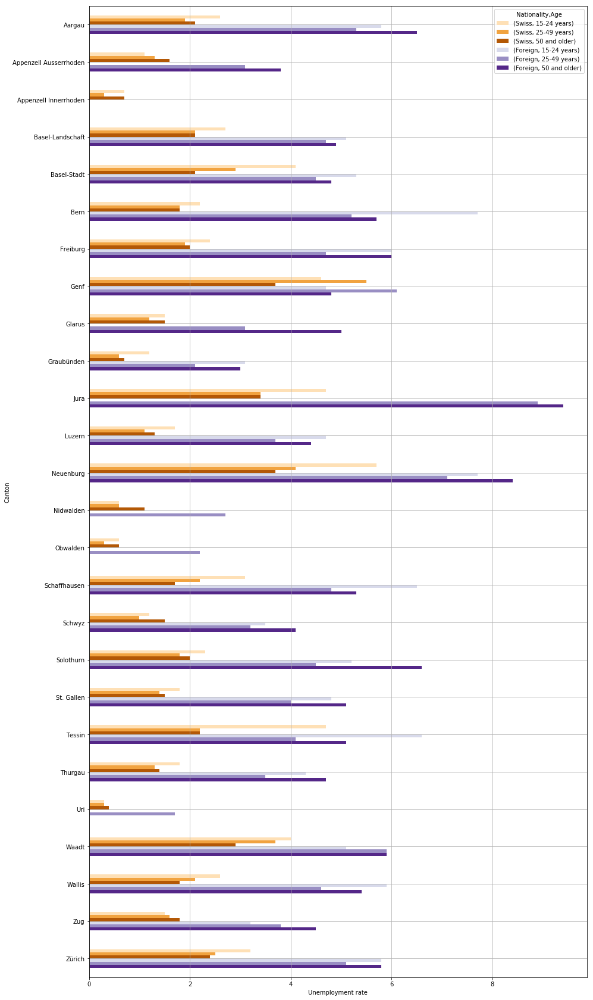

In [32]:
colormap = cm.LinearColormap(['#fee0b6', '#f1a340', '#b35806', '#d8daeb', '#998ec3', '#542788'])
ax = age_unemployment.plot.barh(figsize=(15, 30), grid = True, colormap = colormap)
ax.invert_yaxis()
ax.set_xlabel('Unemployment rate')

## Task 4 (*BONUS*)

*BONUS*: using the map you have just built, and the geographical information contained in it, could you give a *rough estimate* of the difference in unemployment rates between the areas divided by the [Röstigraben](https://en.wikipedia.org/wiki/R%C3%B6stigraben)?

## Task 4 Solution

To obtain the required data, we went to the [amstat](https://www.amstat.ch) website and in the details page selected *Monthly reports (Berichte auf Monatsbasis)* and then *Unemployment and youth unemployment rate according to different criteria (Arbeitslosen- und Jugendarbeitslosenquote)*. In the steps, we chose to include the following:
1. Current reporting month (Aktueller Berichtsmonat)
2. Unemployment rate (Arbeitslosenquote)
3. -
4. -
5. -
6. Canton (Kanton), Language region (Sprachregion)
7. Nationality (Nationalität)

When we obtained the dataset, we made some modifications on the web portal before downloading it. We:
* moved *Nationality* to columns instead of rows,
* moved *Month* and *Metrics* to page-by-page view,
* moved *Nationality* below the *Unemployment rate*,
* sorted rows by *Canton* names,
* sorted columns by *Nationality*,
* reoredered columns *Canton* and *Language region*.

After that, we went to the page for exporting the data and selected the following options:
* export only the displayed part of the report,
* export in CSV file format,
* don't export report title,
* don't export page-by information,
* remove extra columns

We saved this dataset as **Task 4 - Arbeitslosen- und Jugendarbeitslosenquote nach verschiedenen Kriterien.csv**.

After reading the csv file we can see that it is loaded properly, with two columns that contain unemployment rates for Swiss and foreign citizens, as well as the language region of each canton. Lastly, we added the column with canton IDs to our DataFrame.

In [33]:
ch_rosti_file =  os.path.join('data', 'Task 4 - Arbeitslosen- und Jugendarbeitslosenquote nach verschiedenen Kriterien.csv')
ch_rosti = pd.read_csv(ch_rosti_file, encoding = 'utf-16', na_values = '...', index_col = 0)

ch_rosti.rename(columns = {'Schweizer':'Swiss',                        
                           'Ausländer':'Foreign',
                           'Sprachregion': 'Language region'
                          },
                          inplace = True)

ch_rosti['ID_json'] = canton_codes['ID_json'].values
ch_rosti.head()

,Language region,Swiss,Foreign,ID_json
Kanton,,,,
Aargau,Deutsche Schweiz,2.1,5.6,AG
Appenzell Ausserrhoden,Deutsche Schweiz,1.4,3.4,AR
Appenzell Innerrhoden,Deutsche Schweiz,0.5,2.0,AI
Basel-Landschaft,Deutsche Schweiz,2.2,4.8,BL
Basel-Stadt,Deutsche Schweiz,2.8,4.6,BS


In order to facilitate the understanding and the representation of language areas in Switzerland we replaced the values in the column *Sprachregion* of the *ch_rosti* DataFrame with the corresponding languages spoken in particular cantons. However the division in this column is only between the German and the "other" part of Switzerland, which includes all French-speaking cantons as well as the Italian-speaking canton of Ticino (Tessin). Therefore, we separated Ticino canton from the other "non-German" cantons, in order to better represent the division between the French and German parts of Switzerland (*Röstigraben*) and also to include the division between the German and Italian part of Switzerland (*Polentagraben*).

In [34]:
ch_rosti.loc['Tessin', 'Language region'] = 'Italian'
ch_rosti['Language region'].replace(['Deutsche Schweiz', 'Westschweiz und Tessin'], ['German', 'French'], inplace = True)
ch_rosti.head()

,Language region,Swiss,Foreign,ID_json
Kanton,,,,
Aargau,German,2.1,5.6,AG
Appenzell Ausserrhoden,German,1.4,3.4,AR
Appenzell Innerrhoden,German,0.5,2.0,AI
Basel-Landschaft,German,2.2,4.8,BL
Basel-Stadt,German,2.8,4.6,BS


The function *language_color()* is used to generate different colors according to the language that is mostly spoken in the selected cantons. The colors red, blue and yellow are chosen in order to make the differences between language areas more visible on the map on which they will be used in the next step.

In [35]:
lang_dict = {'German':'#feb24c',
             'French':'#3182bd',
             'Italian':'#c51b8a'}

def language_color(kanton_id, region):
    # Get the primary language spoken in the canton
    language = ch_rosti[ch_rosti['ID_json'] == kanton_id]['Language region'].values[0]
    # Check if language is same as the region that is currently being drawn
    if language == region:
        # Return the corresponding color
        return lang_dict[language]
    else:
        return None

New map layers are created and added to the base map in *add_border_layer()* function in order to represent different language areas of Switzerland, while the color of their borders stored in the *color* property is generated using the mentioned *language_color()* function. The *fillColor* of different layers that represent canton borders is irrelevant because the *fillOpacity* property is set to 0 in order to enable the viewer to see the actual rates of unemployment in separate cantons.

In [36]:
rosti_division_map = folium.Map(location = [46.85, 8.23], zoom_start = 8)

def add_border_layer(base_ch_map, language):
    folium.TopoJson(
        ch_topo_data,
        name = language,
        object_path ='objects.cantons',
        style_function=lambda feature: {
            'fillOpacity': 0,
            'weight' : 4,
            'color': language_color(feature['id'], language),
            'opacity': 1        
        }
    ).add_to(base_ch_map)

rosti_division_map.choropleth(
             geo_data = ch_topo_data, 
             name = "Foreign Unemployment rates in Switzerland",
             data = ch_for_unemployment,
             columns = ['ID_json', 'Foreign'],
             key_on = 'feature.id',
             topojson = 'objects.cantons',
             fill_color = 'YlGn',
             fill_opacity = '0.6',
             line_opacity = '0',
             legend_name = 'Percentage of foreign unemployment in Switzerland(%)',
             highlight = True,
            reset = False)
    
add_border_layer(rosti_division_map, 'German')
add_border_layer(rosti_division_map, 'French')
add_border_layer(rosti_division_map, 'Italian')

folium.LayerControl().add_to(rosti_division_map)
rosti_division_map

As can be seen this final map contains all of the information already present on the map IME MAPE created in the Task 3, but also adds a new perspective to the unemployment rates analysis by displaying the borders of the Switzerland language areas. It is visible that the unemployment rates  in the German-speaking cantons are almost always lower than the unemployment rates in the rest or the Switzerland. 